In [4]:
import pandas as pd

In [5]:
dataset = pd.read_csv(r"C:\Users\Admin\Downloads\dataset.csv")
dataset

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,JTMEB3FV6N,Monroe,Key West,FL,33040,2022,TOYOTA,RAV4 PRIME,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,42,0,NaN,198968248,POINT (-81.80023 24.5545),NaN,12087972100
1,1G1RD6E45D,Clark,Laughlin,NV,89029,2013,CHEVROLET,VOLT,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,NaN,5204412,POINT (-114.57245 35.16815),NaN,32003005702
2,JN1AZ0CP8B,Yakima,Yakima,WA,98901,2011,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,73,0,15.0,218972519,POINT (-120.50721 46.60448),PACIFICORP,53077001602
3,1G1FW6S08H,Skagit,Concrete,WA,98237,2017,CHEVROLET,BOLT EV,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,238,0,39.0,186750406,POINT (-121.7515 48.53892),PUGET SOUND ENERGY INC,53057951101
4,3FA6P0SU1K,Snohomish,Everett,WA,98201,2019,FORD,FUSION,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,38.0,2006714,POINT (-122.20596 47.97659),PUGET SOUND ENERGY INC,53061041500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112629,7SAYGDEF2N,King,Duvall,WA,98019,2022,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,45.0,217955265,POINT (-121.98609 47.74068),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032401
112630,1N4BZ1CP7K,San Juan,Friday Harbor,WA,98250,2019,NISSAN,LEAF,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,150,0,40.0,103663227,POINT (-123.01648 48.53448),BONNEVILLE POWER ADMINISTRATION||ORCAS POWER &...,53055960301
112631,1FMCU0KZ4N,King,Vashon,WA,98070,2022,FORD,ESCAPE,Plug-in Hybrid Electric Vehicle (PHEV),Clean Alternative Fuel Vehicle Eligible,38,0,34.0,193878387,POINT (-122.4573 47.44929),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033027702
112632,KNDCD3LD4J,King,Covington,WA,98042,2018,KIA,NIRO,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,26,0,47.0,125039043,POINT (-122.09124 47.33778),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),53033032007


In [6]:
print(dataset.info())
print(dataset.describe())
print(dataset.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112634 entries, 0 to 112633
Data columns (total 17 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   VIN (1-10)                                         112634 non-null  object 
 1   County                                             112634 non-null  object 
 2   City                                               112634 non-null  object 
 3   State                                              112634 non-null  object 
 4   Postal Code                                        112634 non-null  int64  
 5   Model Year                                         112634 non-null  int64  
 6   Make                                               112634 non-null  object 
 7   Model                                              112614 non-null  object 
 8   Electric Vehicle Type                              112634 non-null  object

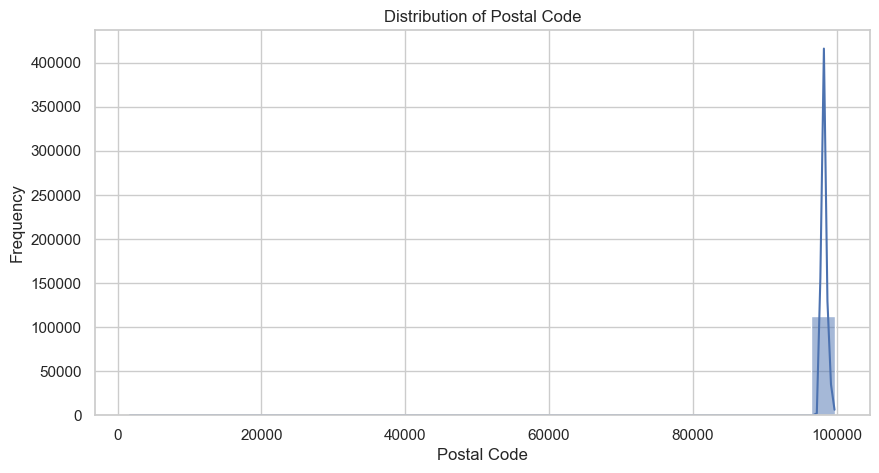

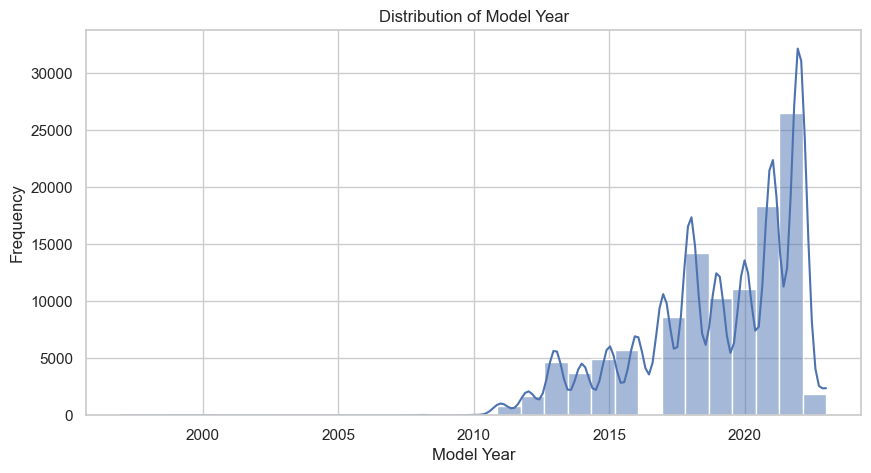

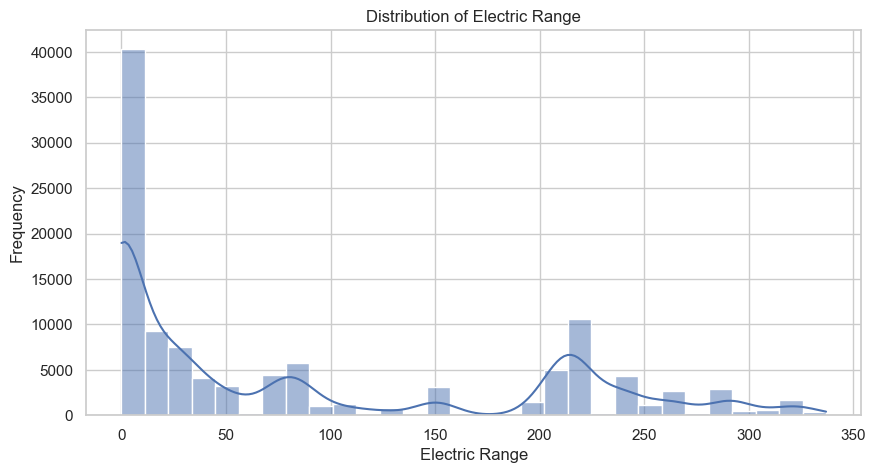

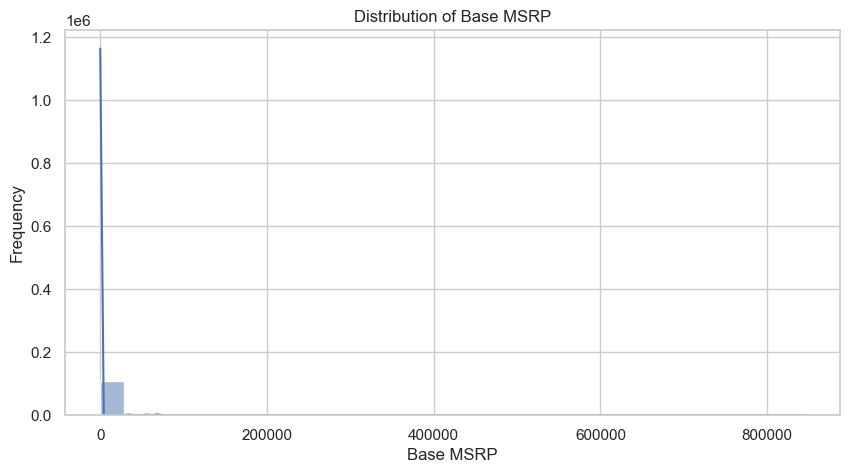

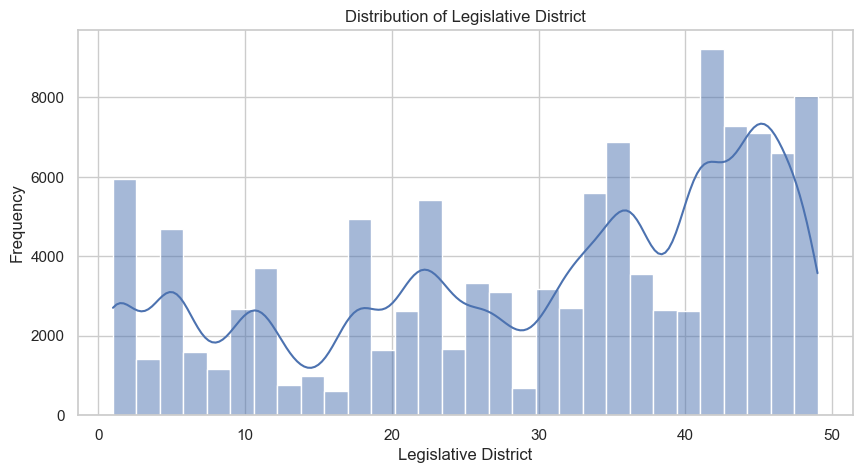

...

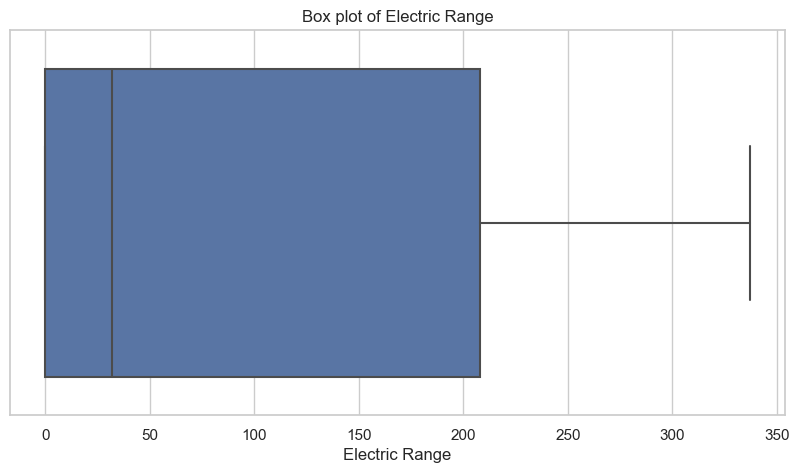

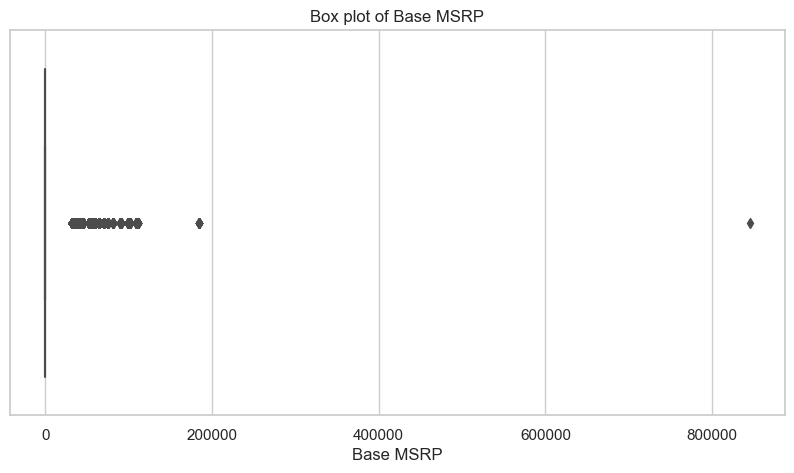

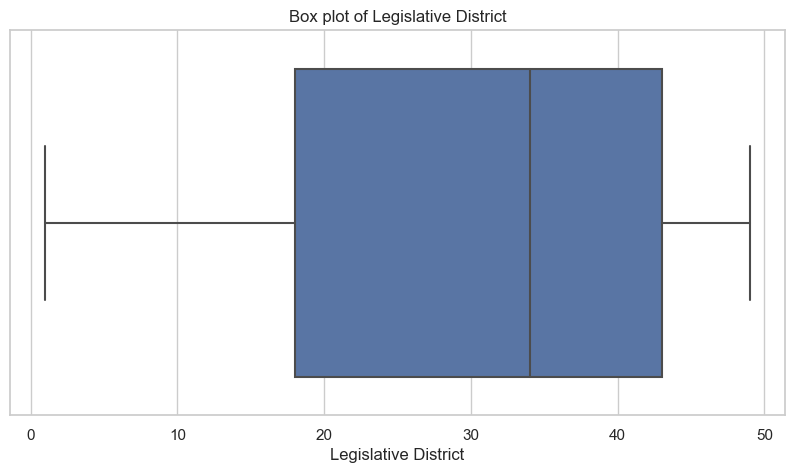

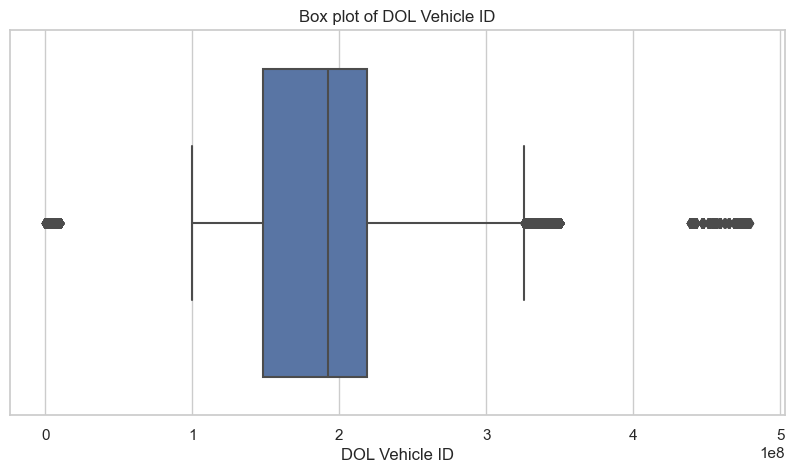

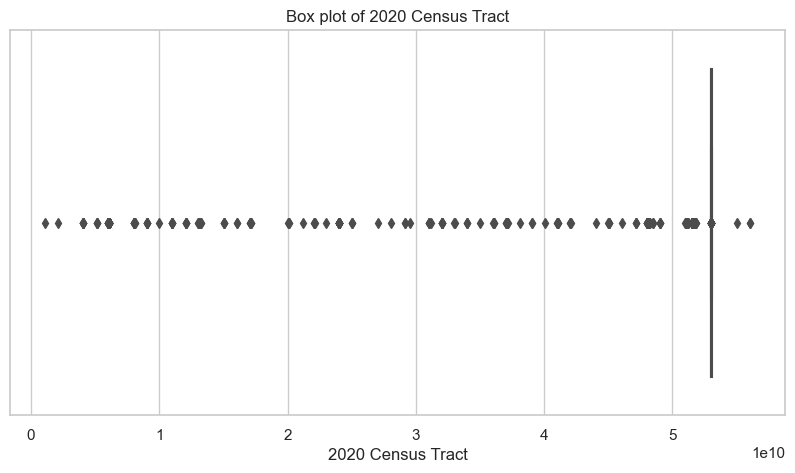

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style="whitegrid")

numerical_features = dataset.select_dtypes(include=['float64', 'int']).columns

for feature in numerical_features:
    plt.figure(figsize=(10, 5))
    sns.histplot(dataset[feature], bins=30, kde=True)
    plt.title(f'Distribution of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.show()

for feature in numerical_features:
    plt.figure(figsize=(10, 5))
    sns.boxplot(x=dataset[feature])
    plt.title(f'Box plot of {feature}')
    plt.xlabel(feature)
    plt.show()


C:\Users\Admin\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


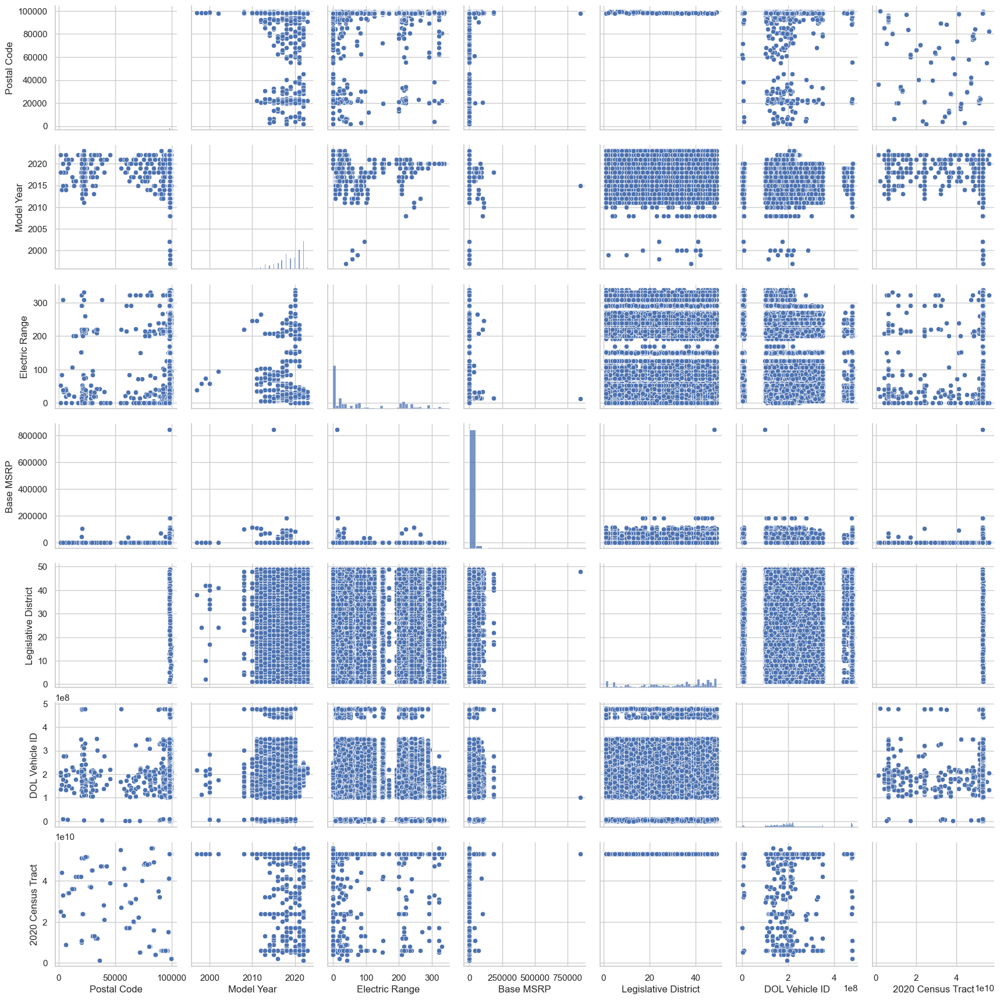

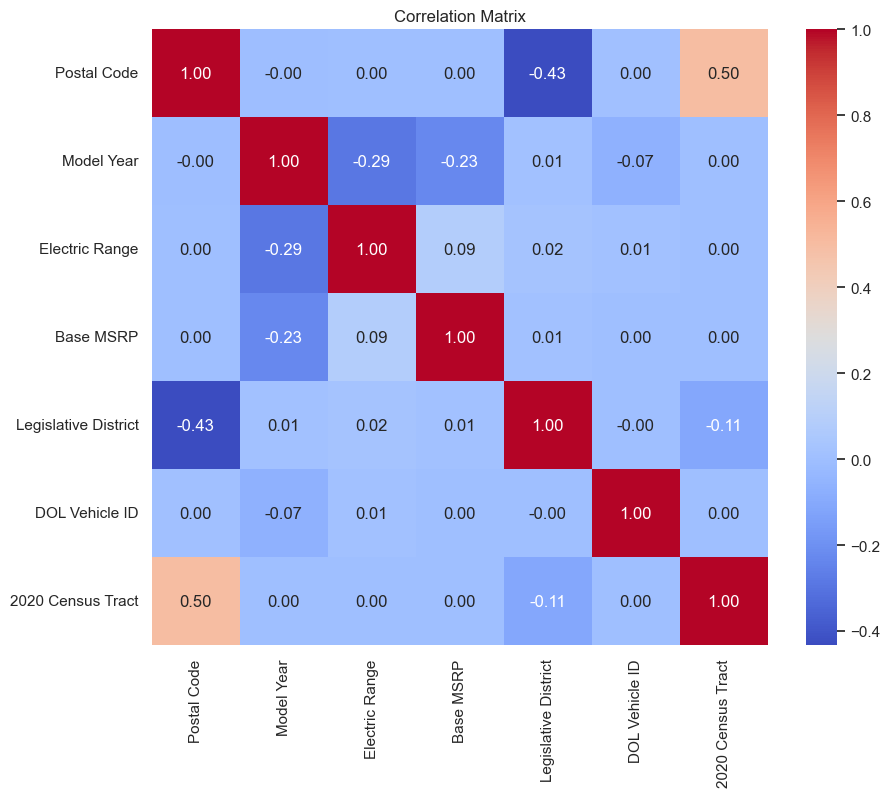

In [8]:
sns.pairplot(dataset[numerical_features])
plt.show()
plt.figure(figsize=(10, 8))
correlation_matrix = dataset[numerical_features].corr()
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm', square=True)
plt.title('Correlation Matrix')
plt.show()


In [9]:
dataset = pd.read_csv(r"C:\Users\Admin\Downloads\dataset.csv")

In [10]:
import plotly.express as px

In [14]:
fig_scatter = px.scatter(dataset, x='Base MSRP', y='Electric Range', 
                         title='Scatter Plot of Electric Range vs Base MSRP')
fig_scatter.show()


fig_box_univariate = px.box(dataset, y='Electric Range', 
                             title='Box Plot of Electric Range')
fig_box_univariate.show()


fig_box_bivariate = px.box(dataset, x='Make', y='Electric Range', 
                            title='Box Plot of Electric Range by Vehicle Make')
fig_box_bivariate.show()


fig_pie = px.pie(dataset, names='Electric Vehicle Type', values='Base MSRP', 
                 title='Distribution of Electric Vehicle Types')
fig_pie.show()

In [13]:
grouped_data = dataset.groupby('State').size().reset_index(name='ev_count')

fig_choropleth = px.choropleth(
    grouped_data,
    locations='State',
    locationmode='USA-states',
    color='ev_count',
    hover_name='State',
    title='Number of EV Vehicles by State',
)

fig_choropleth.show()


grouped_data = dataset.groupby(['Model Year', 'State']).size().reset_index(name='ev_count')
fig_animated_choropleth = px.choropleth(
    grouped_data,
    locations='State',
    locationmode='USA-states',
    color='ev_count',
    hover_name='State',
    title='Number of EV Vehicles by State Over the Years',
    animation_frame='Model Year',  )
fig_animated_choropleth.show()
